## Credit Card Customers 

[Source: Kaggle Credit Card Customers Dataset](https://www.kaggle.com/datasets/sakshigoyal7/credit-card-customers)

A manager at the bank is disturbed with more and more customers leaving their credit card services. They would really appreciate if one could predict for them who is gonna get churned so they can proactively go to the customer to provide them better services and turn customers' decisions in the opposite direction. 

In [1]:
import pandas as pd 
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

In [2]:
bank_data_raw = pd.read_csv('BankChurners.csv')

##### Data Exploration 
From the website, we have noted that there are 23 columns in this dataset: 
- <b>Client Number</b>: Unique identifier of each customer
- <b>Attrition Flag</b>
- <b>Customer Age</b>
- <b>Gender</b>
- <b>Dependent Count</b>
- <b>Education Level</b>
- <b>Marital Status </b>
- <b>Income Category </b>
- <b>Card Category</b>: There are 4 card categories namely <u>Blue, Silver, Gold and Platinum </u> 
- <b>Months on Book</b>: Period of relationship with the bank 
- <b>Total Relationship Count</b>: The total number of products held by the customer 
- <b>Months Inactive </b>: Number of months of being inactive 
- <b>Contact Count </b>: Number of contacts in the last 12 months 
- <b>Credit Limit</b>
- <b>Total Revolving Balance </b>: The unpaid portion of the credit balance which is being carried over to the next period
- <b>Average Open to Buy </b>: The difference between the credit limit and the current balance on the credit card account 
- <b>Total Change Amount </b>: Total change in amount transacted in Q1 and Q4
- <b>Total Trans Amt </b>: Total Transactions amount in the last 12 months
- <b>Total Trans Cnt</b>: Total Transaction count in the last 12 months 
- <b>Total Ct Change Q</b>: Total change in the transaction count between Q1 and Q4 
- <b>Average Credit Card Utilization Ratio</b>: This usually represents the % of your revolving balance and the credit balance allocated to you

In [3]:
import plotly.express as ex
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import plotly.offline as pyo

In [4]:
bank_data_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 23 columns):
 #   Column                                                                                                                              Non-Null Count  Dtype  
---  ------                                                                                                                              --------------  -----  
 0   CLIENTNUM                                                                                                                           10127 non-null  int64  
 1   Attrition_Flag                                                                                                                      10127 non-null  object 
 2   Customer_Age                                                                                                                        10127 non-null  int64  
 3   Gender                                                                           

In [5]:
bank_data = bank_data_raw.iloc[:,:21]

In [148]:
a = bank_data_raw.iloc[:,:21]

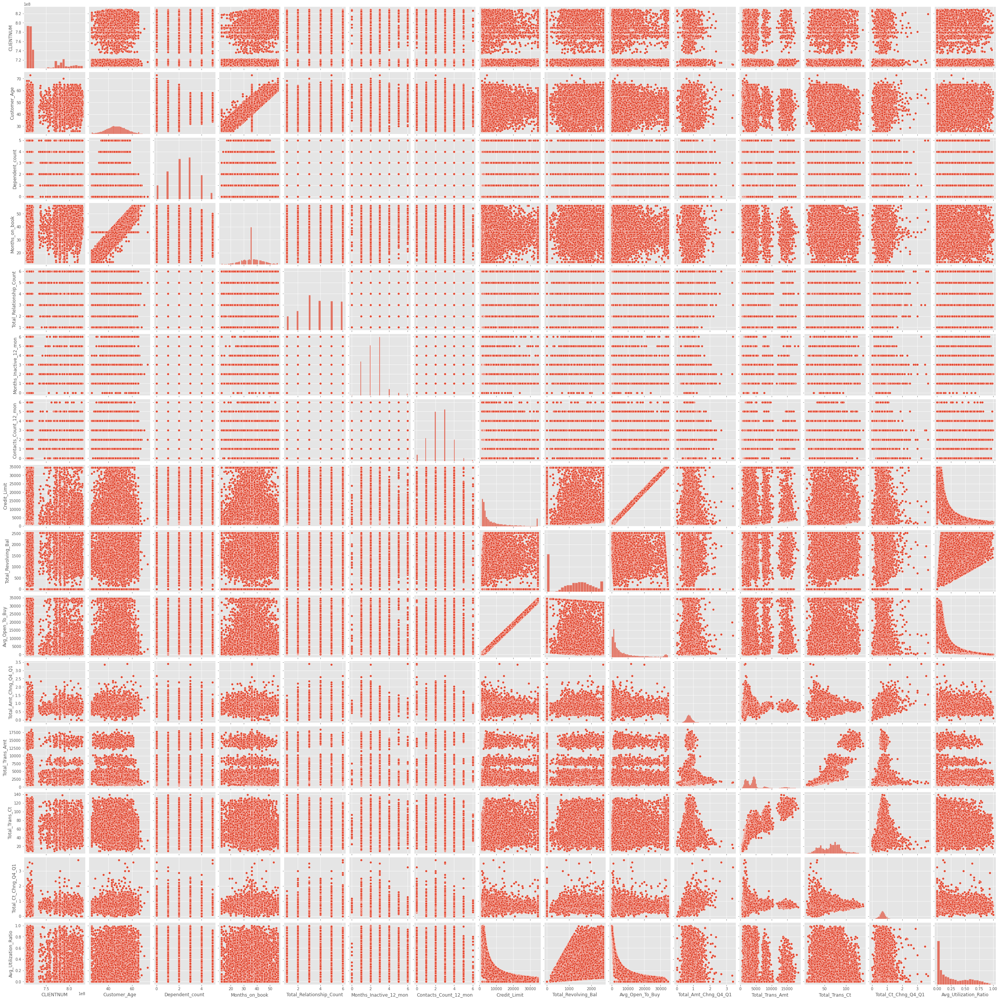

In [150]:
corr_matrix = a.corr()
sns.pairplot(a)

We can see that there is a relationship between: 

- customer age & months on book 
- credit limit & avg open to buy 
- customer age & dependent count: dependent count inceases with age and reaches a peak and drops 
- f(x) = (1/2)^x relationship between the credit limit and average utilization ratio
- f(x) = (1/2)^x relationship between the average open to buy and average utilization ratio

In [6]:
fig = make_subplots(
    rows = 2 , cols = 2 , subplot_titles = ('' , '<b>Platinum Card Holders' , '<b>Blue Card Holders<b>' , 'Residulas'),
    vertical_spacing = 0.09,
    specs = [[{'type': 'pie' , 'rowspan':2 } , {'type' : 'pie'}],
            [None                            , {'type': 'pie'}]
            ]
)

fig.add_trace(
    go.Pie(values = bank_data.Gender.value_counts().values , labels = ['<b>Female<b>' , '<b>Male<b>'] , hole = 0.3 , pull = [0,0.3]),
    row = 1 , col = 1
)

fig.add_trace(
    go.Pie(
        labels = ['Female Platinum Card Holders'  , 'Male Platinum Card Holders'],
        values = bank_data.query('Card_Category == "Platinum"').Gender.value_counts().values , 
        pull = [0, 0.05 , 0.5],
        hole = 0.3
    ),
    row = 1 , col = 2
)

fig.add_trace(
    go.Pie(
        labels = ['Female Blue Card Holders'  , 'Male Blue Card Holders'],
        values = bank_data.query('Card_Category == "Blue"').Gender.value_counts().values , 
        pull = [0, 0.2 , 0.5],
        hole = 0.3
    ),
    row = 2 , col = 2
)

fig.update_layout(
height = 800 , showlegend = True,
title_text = '<b>Distribution of Gender and Different Card Status<b>',)

fig.show()

In [7]:
bank_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 10127 non-null  int64  
 1   Attrition_Flag            10127 non-null  object 
 2   Customer_Age              10127 non-null  int64  
 3   Gender                    10127 non-null  object 
 4   Dependent_count           10127 non-null  int64  
 5   Education_Level           10127 non-null  object 
 6   Marital_Status            10127 non-null  object 
 7   Income_Category           10127 non-null  object 
 8   Card_Category             10127 non-null  object 
 9   Months_on_book            10127 non-null  int64  
 10  Total_Relationship_Count  10127 non-null  int64  
 11  Months_Inactive_12_mon    10127 non-null  int64  
 12  Contacts_Count_12_mon     10127 non-null  int64  
 13  Credit_Limit              10127 non-null  float64
 14  Total_

#### Client Number 

In [8]:
bank_data[bank_data['CLIENTNUM'].duplicated()==True]

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio


#### Attrition Flag

In [9]:
bank_data['Attrition_Flag'].unique()

array(['Existing Customer', 'Attrited Customer'], dtype=object)

In [10]:
bank_data['Attrition_Flag'].value_counts()

Existing Customer    8500
Attrited Customer    1627
Name: Attrition_Flag, dtype: int64

As this will be the factor we will be interested in, we will turn this into a boolean variable. Attrited Customer will have a value of 1 while existing customer will stay as 0.

In [11]:
bank_data['Attrition_Flag'] = np.where(bank_data['Attrition_Flag']=='Attrited Customer', 1,0)

In [12]:
bank_data['Attrition_Flag'].value_counts()

0    8500
1    1627
Name: Attrition_Flag, dtype: int64

#### Education Level

In [13]:
ex.pie(bank_data , names = 'Education_Level' , title = 'Proportion of Education Levels' , hole = 0.5)

#### Marital Status

In [14]:
ex.pie(bank_data , names = 'Marital_Status' , title = 'Proportion of Marital Status' , hole = 0.4)

#### Card Category

In [15]:
ex.pie(bank_data , names = 'Card_Category' , title = 'Proportion of Marital Status' , hole = 0.4)

#### Dependent Count

In [16]:
px.box(bank_data['Dependent_count'],facet_col = 'variable')

In [17]:
px.histogram(bank_data['Dependent_count'])

#### Months on Book

In [18]:
px.box(bank_data['Months_on_book'],facet_col = 'variable')

In [19]:
attrited_data = bank_data.loc[bank_data['Attrition_Flag']==1]

In [20]:
fig = make_subplots(rows = 2 , cols = 1)

fig1 = go.Box(x = attrited_data['Months_on_book'] , name = 'Months on Book Box Plot' , boxmean = True)
fig2 = go.Histogram(x = attrited_data['Months_on_book'] , name = 'Months on the Book Histogram')

fig.add_trace(fig1 , row = 1 , col = 1)
fig.add_trace(fig2 , row = 2 , col = 1)

fig.update_layout(height = 700 , width = 1200 , title_text = 'Distribution of  Months the customer is part of bank')
fig.show()

We can see that most of the customers who left have stayed with the bank for at least 36 months

#### Income Category

In [21]:
bank_data['Income_Category'].value_counts()

Less than $40K    3561
$40K - $60K       1790
$80K - $120K      1535
$60K - $80K       1402
Unknown           1112
$120K +            727
Name: Income_Category, dtype: int64

In [22]:
is_range = bank_data['Income_Category'].str.contains('-',case=False, na=False)

###### Income Category Upper Bound

In [23]:
bank_data.loc[is_range ==True, 'Income Category Upper Bound'] = bank_data['Income_Category'].str.split('- ').str[1]
bank_data.loc[bank_data['Income_Category']=='Less than $40K','Income Category Upper Bound'] = '$40K'
bank_data.loc[bank_data['Income_Category']=='$120K +','Income Category Upper Bound'] = '$160K'
bank_data.loc[bank_data['Income_Category']=='Unknown','Income Category Upper Bound'] = None

In [24]:
bank_data['Income Category Upper Bound'] = bank_data['Income Category Upper Bound'].str.split('$').str[1]
bank_data['Income Category Upper Bound'] = bank_data['Income Category Upper Bound'].str.split('K').str[0]+'000'

In [25]:
bank_data['Income Category Upper Bound'] = pd.to_numeric(bank_data['Income Category Upper Bound'])

In [26]:
bank_data['Income Category Upper Bound'].unique()

array([ 80000.,  40000., 120000.,  60000., 160000.,     nan])

###### Income Category Lower Bound

In [27]:
bank_data.loc[is_range ==True, 'Income Category Lower Bound'] = bank_data['Income_Category'].str.split(' -').str[0]
bank_data.loc[bank_data['Income_Category']=='Less than $40K','Income Category Lower Bound'] = '$0K'
bank_data.loc[bank_data['Income_Category']=='$120K +','Income Category Lower Bound'] = '$120K'
bank_data.loc[bank_data['Income_Category']=='Unknown','Income Category Lower Bound'] = None

In [28]:
bank_data['Income Category Lower Bound'] = bank_data['Income Category Lower Bound'].str.split('$').str[1]
bank_data['Income Category Lower Bound'] = bank_data['Income Category Lower Bound'].str.split('K').str[0]+'000'

In [29]:
bank_data['Income Category Lower Bound'].unique()

array(['60000', '0000', '80000', '40000', '120000', nan], dtype=object)

In [30]:
bank_data['Income Category Lower Bound'] = pd.to_numeric(bank_data['Income Category Lower Bound'])

In [31]:
bank_data['Income Category Lower Bound'].unique()

array([ 60000.,      0.,  80000.,  40000., 120000.,     nan])

#### Other Categories

In [32]:
bank_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 23 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CLIENTNUM                    10127 non-null  int64  
 1   Attrition_Flag               10127 non-null  int64  
 2   Customer_Age                 10127 non-null  int64  
 3   Gender                       10127 non-null  object 
 4   Dependent_count              10127 non-null  int64  
 5   Education_Level              10127 non-null  object 
 6   Marital_Status               10127 non-null  object 
 7   Income_Category              10127 non-null  object 
 8   Card_Category                10127 non-null  object 
 9   Months_on_book               10127 non-null  int64  
 10  Total_Relationship_Count     10127 non-null  int64  
 11  Months_Inactive_12_mon       10127 non-null  int64  
 12  Contacts_Count_12_mon        10127 non-null  int64  
 13  Credit_Limit    

In [33]:
bank_data.iloc[:,9:].columns

Index(['Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'Income Category Upper Bound', 'Income Category Lower Bound'],
      dtype='object')

In [34]:
bank_data_temp = bank_data[['Customer_Age','Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio']]

In [35]:
columns = ('Customer_Age','Months on book', 'Relationship Count', 'Months inactive',
       'Contacts count', 'Credit Limit', 'Total Revolving Bal',
       'Avg Open To Buy', 'Total Amt Chng Q1/Q4', 'Total Trans Amt',
       'Total Trans Ct', 'Total Ct Chng Q4 Q1', 'Avg Utilization Ratio')
index = ('Age','Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio')
newnames = pd.Series(columns, index=index)

In [36]:
fig = px.box(bank_data_temp.melt(), y='value', facet_col = 'variable', boxmode='overlay', color ='variable')
fig.update_yaxes(matches= None)

In [37]:
fig.update_layout(title="Credit Risk Dataset",
                 legend_title="Variables",
                 font=dict(family="Arial", size=4,color="Black"))

### Other Statisics

###### Average Income 

In [38]:
bank_data['Average Income'] =(bank_data['Income Category Lower Bound']+bank_data['Income Category Upper Bound'])/2

In [39]:
bank_data['Average Income'].unique()

array([ 70000.,  20000., 100000.,  50000., 140000.,     nan])

In [40]:
bank_data_income = bank_data.iloc[:, 21:24]

In [41]:
fig = px.box(bank_data_income.melt(), y='value', facet_col = 'variable', boxmode='overlay', color ='variable')
fig.update_yaxes(matches= None)

In [42]:
(bank_data[bank_data['Average Income'].isnull()==True].count())/(bank_data.count())

CLIENTNUM                      0.109805
Attrition_Flag                 0.109805
Customer_Age                   0.109805
Gender                         0.109805
Dependent_count                0.109805
Education_Level                0.109805
Marital_Status                 0.109805
Income_Category                0.109805
Card_Category                  0.109805
Months_on_book                 0.109805
Total_Relationship_Count       0.109805
Months_Inactive_12_mon         0.109805
Contacts_Count_12_mon          0.109805
Credit_Limit                   0.109805
Total_Revolving_Bal            0.109805
Avg_Open_To_Buy                0.109805
Total_Amt_Chng_Q4_Q1           0.109805
Total_Trans_Amt                0.109805
Total_Trans_Ct                 0.109805
Total_Ct_Chng_Q4_Q1            0.109805
Avg_Utilization_Ratio          0.109805
Income Category Upper Bound    0.000000
Income Category Lower Bound    0.000000
Average Income                 0.000000
dtype: float64

Around <b>10%</b> of the entire dataset has an <b>"Unknown"</b> value of <b>income category</b>.

This is a substantial percentage of the whole dataset. Hence, deleting the whole record will cause us to lose a significant chunk of data and information.

In [43]:
bank_data[bank_data['Average Income'].isnull()==True]

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Income Category Upper Bound,Income Category Lower Bound,Average Income
19,709327383,0,45,F,2,Graduate,Married,Unknown,Blue,37,...,1157,13313.0,0.966,1207,21,0.909,0.080,NaN,NaN,NaN
28,718813833,0,44,F,3,Uneducated,Single,Unknown,Blue,34,...,0,10100.0,0.525,1052,18,1.571,0.000,NaN,NaN,NaN
39,708300483,1,66,F,0,Doctorate,Married,Unknown,Blue,56,...,605,7277.0,1.052,704,16,0.143,0.077,NaN,NaN,NaN
44,720572508,0,38,F,4,Graduate,Single,Unknown,Blue,28,...,2055,7775.0,0.977,1042,23,0.917,0.209,NaN,NaN,NaN
58,711427458,0,44,F,5,Graduate,Married,Unknown,Blue,35,...,978,5295.0,2.275,1359,25,1.083,0.156,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10021,711149133,1,30,F,1,Graduate,Married,Unknown,Blue,18,...,2517,1860.0,0.941,8759,74,0.609,0.575,NaN,NaN,NaN
10040,714677583,1,50,F,3,Doctorate,Single,Unknown,Blue,36,...,0,5173.0,0.912,8757,68,0.789,0.000,NaN,NaN,NaN
10083,718170033,0,42,F,4,Uneducated,Married,Unknown,Blue,23,...,0,8348.0,0.695,15905,111,0.708,0.000,NaN,NaN,NaN
10092,713437008,1,40,F,3,Graduate,Married,Unknown,Blue,25,...,1878,5010.0,1.059,9038,64,0.829,0.273,NaN,NaN,NaN


### Summary and Data Checks

In [44]:
bank_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 24 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CLIENTNUM                    10127 non-null  int64  
 1   Attrition_Flag               10127 non-null  int64  
 2   Customer_Age                 10127 non-null  int64  
 3   Gender                       10127 non-null  object 
 4   Dependent_count              10127 non-null  int64  
 5   Education_Level              10127 non-null  object 
 6   Marital_Status               10127 non-null  object 
 7   Income_Category              10127 non-null  object 
 8   Card_Category                10127 non-null  object 
 9   Months_on_book               10127 non-null  int64  
 10  Total_Relationship_Count     10127 non-null  int64  
 11  Months_Inactive_12_mon       10127 non-null  int64  
 12  Contacts_Count_12_mon        10127 non-null  int64  
 13  Credit_Limit    

In [45]:
bank_data.describe()

,CLIENTNUM,Attrition_Flag,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Income Category Upper Bound,Income Category Lower Bound,Average Income
count,1.012700e+04,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,9015.000000,9015.000000,9015.000000
mean,7.391776e+08,0.160660,46.325960,2.346203,35.928409,3.812580,2.341167,2.455317,8631.953698,1162.814061,7469.139637,0.759941,4404.086304,64.858695,0.712222,0.274894,73490.848586,40572.379368,57031.613977
std,3.690378e+07,0.367235,8.016814,1.298908,7.986416,1.554408,1.010622,1.106225,9088.776650,814.987335,9090.685324,0.219207,3397.129254,23.472570,0.238086,0.275691,38180.905718,38504.675016,38043.693409
min,7.080821e+08,0.000000,26.000000,0.000000,13.000000,1.000000,0.000000,0.000000,1438.300000,0.000000,3.000000,0.000000,510.000000,10.000000,0.000000,0.000000,40000.000000,0.000000,20000.000000
25%,7.130368e+08,0.000000,41.000000,1.000000,31.000000,3.000000,2.000000,2.000000,2555.000000,359.000000,1324.500000,0.631000,2155.500000,45.000000,0.582000,0.023000,40000.000000,0.000000,20000.000000
50%,7.179264e+08,0.000000,46.000000,2.000000,36.000000,4.000000,2.000000,2.000000,4549.000000,1276.000000,3474.000000,0.736000,3899.000000,67.000000,0.702000,0.176000,60000.000000,40000.000000,50000.000000
75%,7.731435e+08,0.000000,52.000000,3.000000,40.000000,5.000000,3.000000,3.000000,11067.500000,1784.000000,9859.000000,0.859000,4741.000000,81.000000,0.818000,0.503000,120000.000000,80000.000000,100000.000000
max,8.283431e+08,1.000000,73.000000,5.000000,56.000000,6.000000,6.000000,6.000000,34516.000000,2517.000000,34516.000000,3.397000,18484.000000,139.000000,3.714000,0.999000,160000.000000,120000.000000,140000.000000


#### Regression 

[Source: sklearn.ensemble.HistGradientBoostingClassifier](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.HistGradientBoostingClassifier.html)

As there are some Nan values are present in the dataset and these Nan records make up a substantial percentage of the dataset, we will be using the `sklearn.ensemble.HistGradientBoostingClassifier` instead of deleting the null values.

###### Predicting Average Income with Null Values:

In [46]:
bank_data = bank_data.drop(['Income_Category','Income Category Lower Bound', 
                  'Income Category Upper Bound', 'CLIENTNUM'], axis=1)

In [47]:
bank_data_regress = pd.get_dummies(bank_data)

In [48]:
test_data = bank_data_regress[bank_data_regress['Average Income'].isnull()]

In [49]:
bank_data_regress.dropna(inplace=True)

In [50]:
Y_train = bank_data_regress['Average Income']

We will drop some of the following columns from the list of X variables to prevent any inaccuracy in the prediction: 

- <b>Average Income</b>: This will be our dependent variable
- <b>Income Category Lower Bound </b>and <b>Income Category Upper Bound</b> 
- <b>CLIENTNUM </b>: This is only an identifier and should not have any relationship with the y variable 
- <b>Gender_M </b>:This is to prevent mutlicollinearity as gender could only be F/M 
- <b>Education_Level_Unknown</b> and <b>Marital_Status_Unknown</b>: To prevent multicollinearity
- <b>Card_Category_Silver</b>: To prevent multicollinearity

In [51]:
columns_to_drop = ['Avg_Utilization_Ratio', 'Average Income', 'Gender_M','Education_Level_Unknown','Marital_Status_Unknown', 
                  'Card_Category_Silver']

In [52]:
X_train = bank_data_regress.drop(columns_to_drop, axis=1)
X_test = test_data.drop(columns_to_drop, axis=1)

In [53]:
from sklearn.linear_model import LinearRegression

In [54]:
from sklearn import datasets, linear_model
import statsmodels.api as sm
from scipy import stats

In [55]:
X2 = sm.add_constant(X_train)
est = sm.OLS(Y_train, X2)
est2 = est.fit()
print(est2.summary())

                            OLS Regression Results                            
Dep. Variable:         Average Income   R-squared:                       0.662
Model:                            OLS   Adj. R-squared:                  0.661
Method:                 Least Squares   F-statistic:                     677.0
Date:                Sat, 11 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:53:07   Log-Likelihood:            -1.0298e+05
No. Observations:                9015   AIC:                         2.060e+05
Df Residuals:                    8988   BIC:                         2.062e+05
Df Model:                          26                                         
Covariance Type:            nonrobust                                         
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const         

In [56]:
est2.pvalues>0.1

const                            False
Attrition_Flag                   False
Customer_Age                     False
Dependent_count                  False
Months_on_book                    True
Total_Relationship_Count          True
Months_Inactive_12_mon            True
Contacts_Count_12_mon             True
Credit_Limit                     False
Total_Revolving_Bal              False
Avg_Open_To_Buy                  False
Total_Amt_Chng_Q4_Q1              True
Total_Trans_Amt                  False
Total_Trans_Ct                   False
Total_Ct_Chng_Q4_Q1               True
Gender_F                         False
Education_Level_College           True
Education_Level_Doctorate         True
Education_Level_Graduate          True
Education_Level_High School       True
Education_Level_Post-Graduate     True
Education_Level_Uneducated        True
Marital_Status_Divorced           True
Marital_Status_Married           False
Marital_Status_Single             True
Card_Category_Blue       

Variables with P-value > 0.1: 
- Months_on_book                    
- Total_Relationship_Count          
- Months_Inactive_12_mon           
- Contacts_Count_12_mon             
- Total_Amt_Chng_Q4_Q1              
- Total_Ct_Chng_Q4_Q1               
- Education_Level_College           
- Education_Level_Doctorate         
- Education_Level_Graduate         
- Education_Level_High School      
- Education_Level_Post-Graduate
- Education_Level_Uneducated       
- Marital_Status_Divorced           
- Marital_Status_Single             
- Card_Category_Gold                
- Card_Category_Platinum            

In [57]:
columns_to_drop_2 = ['Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon','Contacts_Count_12_mon', 
                    'Total_Amt_Chng_Q4_Q1', 'Total_Ct_Chng_Q4_Q1','Education_Level_College','Education_Level_Doctorate',
                    'Education_Level_Graduate', 'Education_Level_High School', 'Education_Level_Post-Graduate',
                    'Education_Level_Uneducated', 'Marital_Status_Divorced', 'Marital_Status_Single', 'Card_Category_Gold',
                    'Card_Category_Platinum']

In [58]:
X_train2 = X_train.drop(columns_to_drop_2, axis=1)
X_test2 = X_test.drop(columns_to_drop_2, axis=1)

In [59]:
X2 = sm.add_constant(X_train2)
est = sm.OLS(Y_train, X2)
est2 = est.fit()
print(est2.summary())

                            OLS Regression Results                            
Dep. Variable:         Average Income   R-squared:                       0.662
Model:                            OLS   Adj. R-squared:                  0.661
Method:                 Least Squares   F-statistic:                     1760.
Date:                Sat, 11 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:53:07   Log-Likelihood:            -1.0298e+05
No. Observations:                9015   AIC:                         2.060e+05
Df Residuals:                    9004   BIC:                         2.061e+05
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                   2.74

In [60]:
from sklearn.model_selection import train_test_split

In [61]:
X_used, X_not_used, Y_used, Y_not_used = train_test_split(X_train2,Y_train, test_size = 0.9, random_state = 101)

In [62]:
X_used.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 901 entries, 7649 to 1697
Data columns (total 11 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Attrition_Flag          901 non-null    int64  
 1   Customer_Age            901 non-null    int64  
 2   Dependent_count         901 non-null    int64  
 3   Credit_Limit            901 non-null    float64
 4   Total_Revolving_Bal     901 non-null    int64  
 5   Avg_Open_To_Buy         901 non-null    float64
 6   Total_Trans_Amt         901 non-null    int64  
 7   Total_Trans_Ct          901 non-null    int64  
 8   Gender_F                901 non-null    uint8  
 9   Marital_Status_Married  901 non-null    uint8  
 10  Card_Category_Blue      901 non-null    uint8  
dtypes: float64(2), int64(6), uint8(3)
memory usage: 66.0 KB


In [63]:
lm = LinearRegression()

In [64]:
lm.fit(X_used, Y_used)

LinearRegression()

In [65]:
Y_pred = lm.predict(X_test2)

In [66]:
bank_data.loc[bank_data['Average Income'].isnull(),'Average Income']=Y_pred 

In [67]:
bank_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Attrition_Flag            10127 non-null  int64  
 1   Customer_Age              10127 non-null  int64  
 2   Gender                    10127 non-null  object 
 3   Dependent_count           10127 non-null  int64  
 4   Education_Level           10127 non-null  object 
 5   Marital_Status            10127 non-null  object 
 6   Card_Category             10127 non-null  object 
 7   Months_on_book            10127 non-null  int64  
 8   Total_Relationship_Count  10127 non-null  int64  
 9   Months_Inactive_12_mon    10127 non-null  int64  
 10  Contacts_Count_12_mon     10127 non-null  int64  
 11  Credit_Limit              10127 non-null  float64
 12  Total_Revolving_Bal       10127 non-null  int64  
 13  Avg_Open_To_Buy           10127 non-null  float64
 14  Total_

### Logistic Regression:  Predicting the possibility of attrition 

In [68]:
import statsmodels.api as sm

In [69]:
corr_matrix = bank_data_regress.corr()

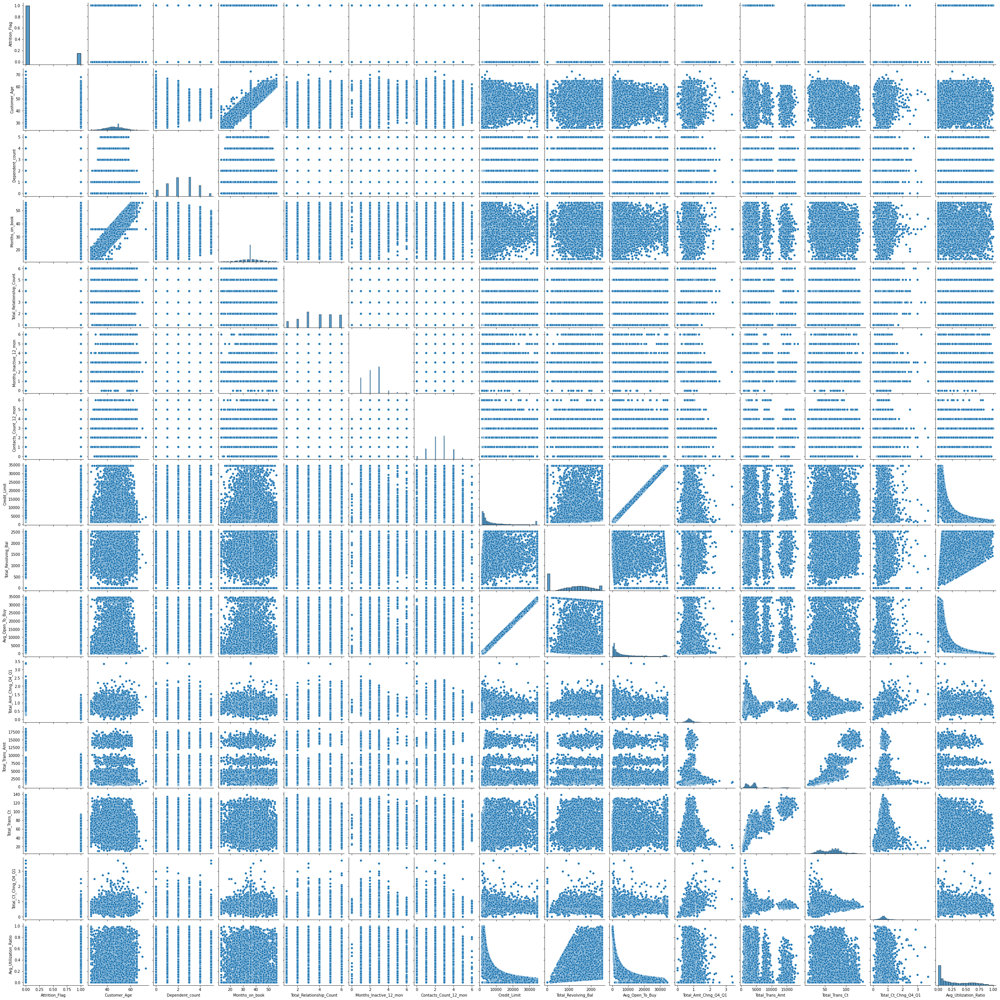

In [70]:
sns.pairplot(bank_data_regress.iloc[:,:15])

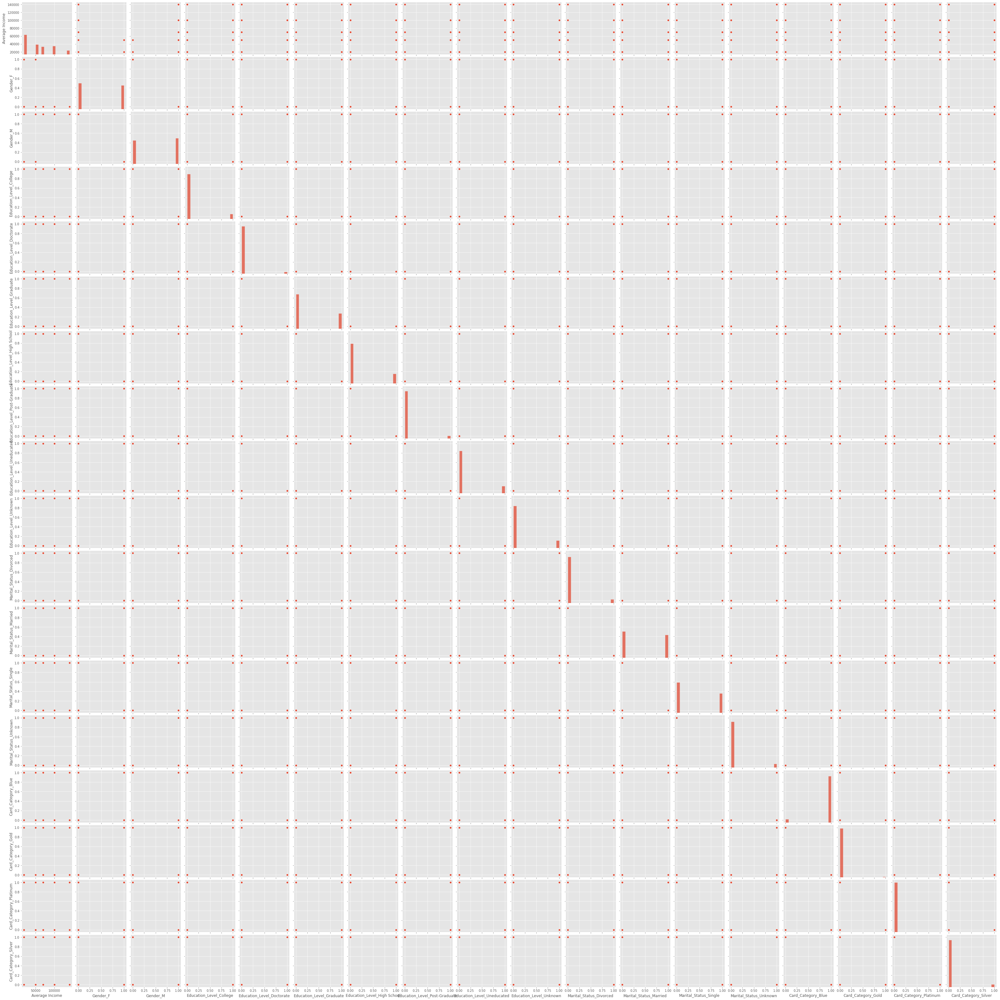

In [147]:
sns.pairplot(bank_data_regress.iloc[:,15:])

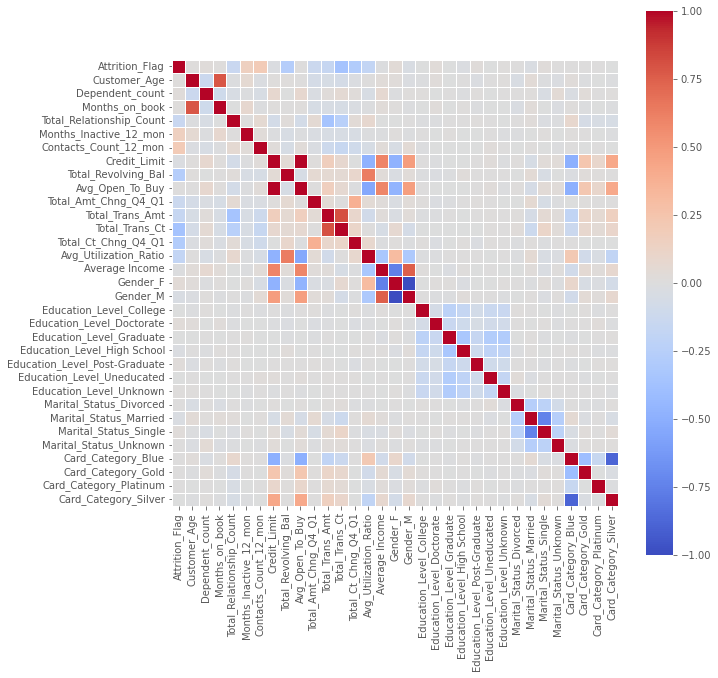

In [71]:
plt.style.use('ggplot')
fig = plt.figure(figsize=(10, 10))
g = sns.heatmap(corr_matrix, cmap='coolwarm', square=True, linecolor='w', linewidth=.5)
plt.show()

In [72]:
bank_data = pd.get_dummies(bank_data)

In [73]:
bank_data.drop(columns_to_drop, axis=1, inplace=True)

In [74]:
bank_data.drop(columns_to_drop_2, axis=1, inplace=True)

In [75]:
bank_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 11 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Attrition_Flag          10127 non-null  int64  
 1   Customer_Age            10127 non-null  int64  
 2   Dependent_count         10127 non-null  int64  
 3   Credit_Limit            10127 non-null  float64
 4   Total_Revolving_Bal     10127 non-null  int64  
 5   Avg_Open_To_Buy         10127 non-null  float64
 6   Total_Trans_Amt         10127 non-null  int64  
 7   Total_Trans_Ct          10127 non-null  int64  
 8   Gender_F                10127 non-null  uint8  
 9   Marital_Status_Married  10127 non-null  uint8  
 10  Card_Category_Blue      10127 non-null  uint8  
dtypes: float64(2), int64(6), uint8(3)
memory usage: 662.7 KB


In [76]:
Y = bank_data['Attrition_Flag']
X = bank_data.iloc[:, 1:]

In [77]:
X2 = sm.add_constant(X)
est = sm.OLS(Y, X)
est2 = est.fit()
print(est2.summary())

                                 OLS Regression Results                                
Dep. Variable:         Attrition_Flag   R-squared (uncentered):                   0.334
Model:                            OLS   Adj. R-squared (uncentered):              0.333
Method:                 Least Squares   F-statistic:                              563.9
Date:                Sat, 11 Mar 2023   Prob (F-statistic):                        0.00
Time:                        12:54:07   Log-Likelihood:                         -3052.6
No. Observations:               10127   AIC:                                      6123.
Df Residuals:                   10118   BIC:                                      6188.
Df Model:                           9                                                  
Covariance Type:            nonrobust                                                  
                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------

In [78]:
from sklearn.linear_model import LogisticRegression

In [79]:
log_reg = LogisticRegression(solver = 'liblinear')

In [80]:
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size = 0.3, random_state = 101)

In [81]:
log_reg.fit(X_train, Y_train)

LogisticRegression(solver='liblinear')

In [82]:
Y_pred = log_reg.predict(X_test)

In [83]:
from sklearn import metrics

In [84]:
print("Accuracy:",round(metrics.accuracy_score(Y_test, Y_pred),3))
print("Precision:",metrics.precision_score(Y_test, Y_pred))
print("Recall:",metrics.recall_score(Y_test, Y_pred))

Accuracy: 0.86
Precision: 0.6859903381642513
Recall: 0.28286852589641437


### Decision Tree

Since our Y-variable is a categorical variable,  we would be using DecisionTreeClassifier instead of DecisionTreeRegressor for this dataset

[Source: Decision Tree Classifier and Regression](https://www.numpyninja.com/post/is-decision-tree-a-classification-or-regression-model)

In [113]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3,random_state=109)

In [106]:
from sklearn.metrics import r2_score

In [107]:
from sklearn.tree import DecisionTreeClassifier

decision_trees = DecisionTreeClassifier()

clf = decision_trees.fit(X_train, Y_train)

Y_pred = decision_trees.predict(X_test)

In [108]:
from sklearn import tree

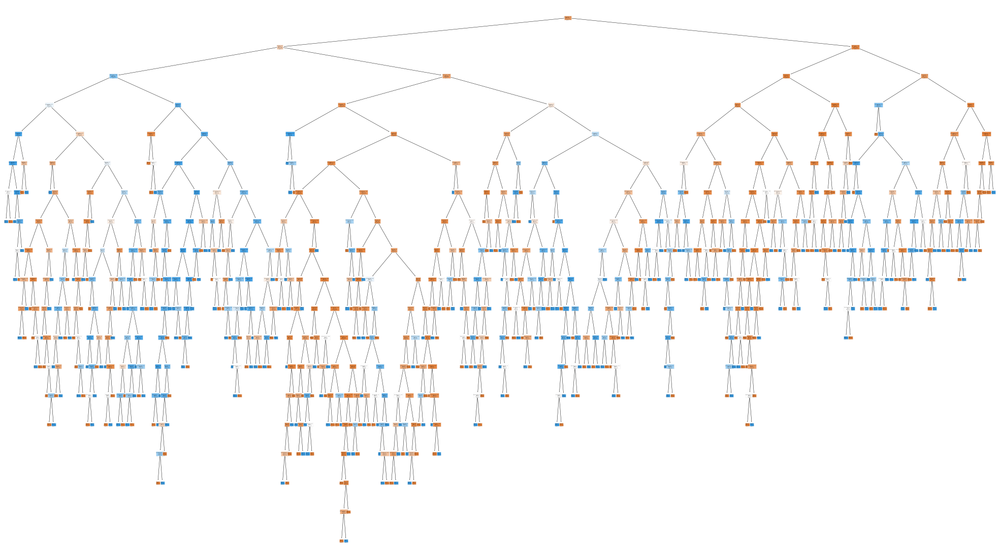

In [90]:
fig = plt.figure(figsize=(35,20))
_ = tree.plot_tree(clf,
                   feature_names=bank_data.columns,  
                   class_names='Attrition Flag',
                   filled=True)

In [95]:
print("Accuracy:",round(metrics.accuracy_score(Y_test, Y_pred),3))
print("Precision:",metrics.precision_score(Y_test, Y_pred))
print("Recall:",metrics.recall_score(Y_test, Y_pred))

Accuracy: 0.91
Precision: 0.7042553191489361
Recall: 0.7103004291845494


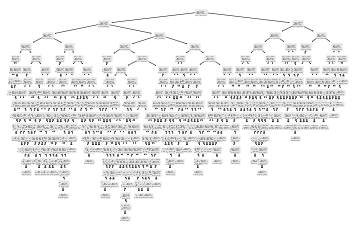

In [101]:
tree.plot_tree(clf) 
plt.savefig('DT.pdf')

### Random Forest

In [92]:
from sklearn.ensemble import RandomForestClassifier

In [93]:
rf = RandomForestClassifier(n_estimators = 1000, random_state = 42)

In [94]:
rf.fit(X_train, Y_train)

RandomForestClassifier(n_estimators=1000, random_state=42)

In [96]:
Y_pred = rf.predict(X_test)

In [97]:
errors = abs(Y_pred - Y_test)
MAE = round(np.mean(errors), 2)
print('Mean Absolute Error:', MAE, 'degrees.')

Mean Absolute Error: 0.06 degrees.


In [98]:
accuracy = rf.score(X_test, Y_test)
print("Accuracy: " + str(accuracy))

Accuracy: 0.9381375452451465


In [99]:
from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(Y_test, Y_pred)
print(confusion_matrix)

[[2509   64]
 [ 124  342]]


In [100]:
Y_pred_prob = rf.predict_proba(X_test)
accuracy = rf.score(X_test, Y_test)
print("Accuracy: " + str(accuracy))

Accuracy: 0.9381375452451465
